In [1]:
#load packages and directory
import scanpy as sc
import seaborn as sns
import numpy as np
import anndata as ad
import scvi
import pandas as pd
import matplotlib.pyplot as plt
import scipy
directory = '/Users/david/Dropbox/RNASeq/VP'

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## pre-processing

In [12]:
#load pre-processed rat neurons
adatar = sc.read_h5ad('/Users/david/Dropbox/RNASeq/Rat/neurons.h5ad')

In [13]:
#load pre-processed mouse neurons
adatam = sc.read_h5ad('/Users/david/Dropbox/RNASeq/HFD/neurons.h5ad')

In [14]:
adatar.obs['Species']='Rat'
adatam.obs['Species']='Mouse'

In [15]:
#only look at rat neurons from the VP tissue dissections (not NAc tissue)
adatar = adatar[adatar.obs['Sample'].isin(['V1','V2'])]

In [16]:
adata = sc.concat([adatam,adatar])

In [17]:
del(adatam,adatar)

In [ ]:
# integrate these neurons using scVI for new UMAP

In [18]:
adata_scvi = adata.copy()

In [19]:
sc.pp.highly_variable_genes(adata_scvi, n_top_genes = 2000, subset = True, layer='counts', flavor = 'seurat_v3', batch_key='Sample')

In [20]:
scvi.model.SCVI.setup_anndata(adata_scvi, layer = 'counts',
                             batch_key='Sample',
                             continuous_covariate_keys=['total_counts'],
                             categorical_covariate_keys=['Species'])

#these are the recommended settings for integrating multiple datasets
model = scvi.model.SCVI(adata_scvi, n_layers=2, n_latent=30, gene_likelihood="nb")

In [21]:
model.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 1/288:   0%|                                      | 0/288 [00:00<?, ?it/s]

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/abc.py:119: FutureWarning: SparseDataset is deprecated and will be removed in late 2024. It has been replaced by the public classes CSRDataset and CSCDataset.

For instance checks, use `isinstance(X, (anndata.experimental.CSRDataset, anndata.experimental.CSCDataset))` instead.

For creation, use `anndata.experimental.sparse_dataset(X)` instead.

  return _abc_instancecheck(cls, instance)


Epoch 288/288: 100%|█| 288/288 [14:27<00:00,  3.05s/it, v_num=1, train_loss_step

`Trainer.fit` stopped: `max_epochs=288` reached.


Epoch 288/288: 100%|█| 288/288 [14:27<00:00,  3.01s/it, v_num=1, train_loss_step


In [22]:
adata.obsm['X_scVI'] = model.get_latent_representation()

In [23]:
del(adata_scvi)

In [24]:
sc.pp.neighbors(adata, use_rep = 'X_scVI', method = 'umap', n_neighbors=15)

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


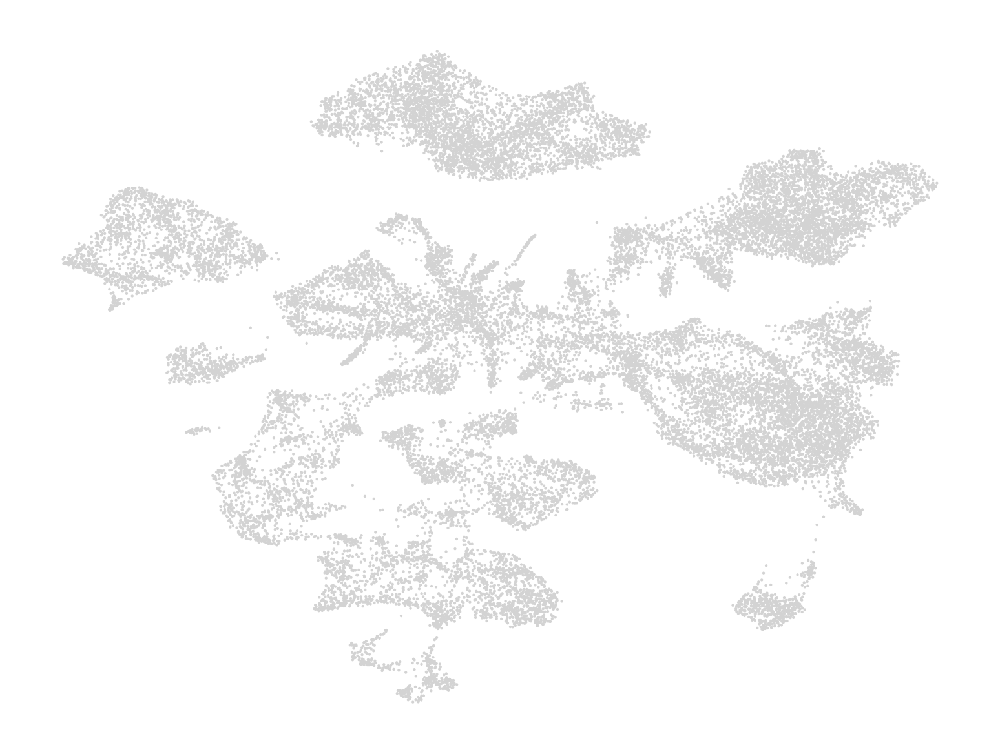

In [58]:
sc.tl.umap(adata, min_dist=0.5)
sc.pl.umap(adata, frameon = False)

In [29]:
#get NT info
allMeta = pd.read_csv('/Users/david/Dropbox/RNASeq/AllenPAL/Data/cell_metadata_with_cluster_annotation.csv')

(sts,ci) = np.unique(allMeta['supertype'].to_numpy(),return_index=True)
nt = allMeta['neurotransmitter'].to_numpy()[ci]
nt[nt!=nt]='None'
stnt = dict(zip(sts,nt))
adata.obs['neurotransmitter'] = adata.obs.supertype.map(stnt)

(classes,ci) = np.unique(allMeta['class'].to_numpy(),return_index=True)
cc = allMeta['class_color'].to_numpy()[ci]
classp = dict(zip(classes,cc))
classp['None']=(0.8,0.8,0.8,0.2)

(subclasses,si) = np.unique(allMeta['subclass'].to_numpy(),return_index=True)
scc = allMeta['subclass_color'].to_numpy()[si]
subclassp = dict(zip(subclasses,scc))
subclassp['None']=(0.8,0.8,0.8,0.2)

ntlist=allMeta['neurotransmitter'][allMeta['neurotransmitter']==allMeta['neurotransmitter']].to_numpy()
ntclist=allMeta['neurotransmitter_color'][allMeta['neurotransmitter']==allMeta['neurotransmitter']].to_numpy()
(neurotransmitters,ni) = np.unique(ntlist,return_index=True)
nc = ntclist[ni]
neurotransmitterp = dict(zip(neurotransmitters,nc))
neurotransmitterp['None']=(0.8,0.8,0.8,0.2)

del(allMeta)

In [225]:
adata.write_h5ad(directory + '/MouseRatVP.h5ad')

In [268]:
adata.shape

(27731, 14926)

## preliminary analysis

In [3]:
adata = sc.read_h5ad(directory + '/MouseRatVP.h5ad')

In [3]:
#get color palettes
allMeta = pd.read_csv('/Users/david/Dropbox/RNASeq/AllenPAL/Data/cell_metadata_with_cluster_annotation.csv')

(classes,ci) = np.unique(allMeta['class'].to_numpy(),return_index=True)
cc = allMeta['class_color'].to_numpy()[ci]
classp = dict(zip(classes,cc))
classp['None']=(0.8,0.8,0.8,0.2)

(subclasses,si) = np.unique(allMeta['subclass'].to_numpy(),return_index=True)
scc = allMeta['subclass_color'].to_numpy()[si]
subclassp = dict(zip(subclasses,scc))
subclassp['None']=(0.8,0.8,0.8,0.2)

ntlist=allMeta['neurotransmitter'][allMeta['neurotransmitter']==allMeta['neurotransmitter']].to_numpy()
ntclist=allMeta['neurotransmitter_color'][allMeta['neurotransmitter']==allMeta['neurotransmitter']].to_numpy()
(neurotransmitters,ni) = np.unique(ntlist,return_index=True)
nc = ntclist[ni]
neurotransmitterp = dict(zip(neurotransmitters,nc))
neurotransmitterp['None']=(0.8,0.8,0.8,0.2)

del(allMeta)

/var/folders/0d/m1rp2vsn40550y2btkrfwptr0000gn/T/ipykernel_49109/3778227727.py:2: DtypeWarning: Columns (16) have mixed types. Specify dtype option on import or set low_memory=False.
  allMeta = pd.read_csv('/Users/david/Dropbox/RNASeq/AllenPAL/Data/cell_metadata_with_cluster_annotation.csv')


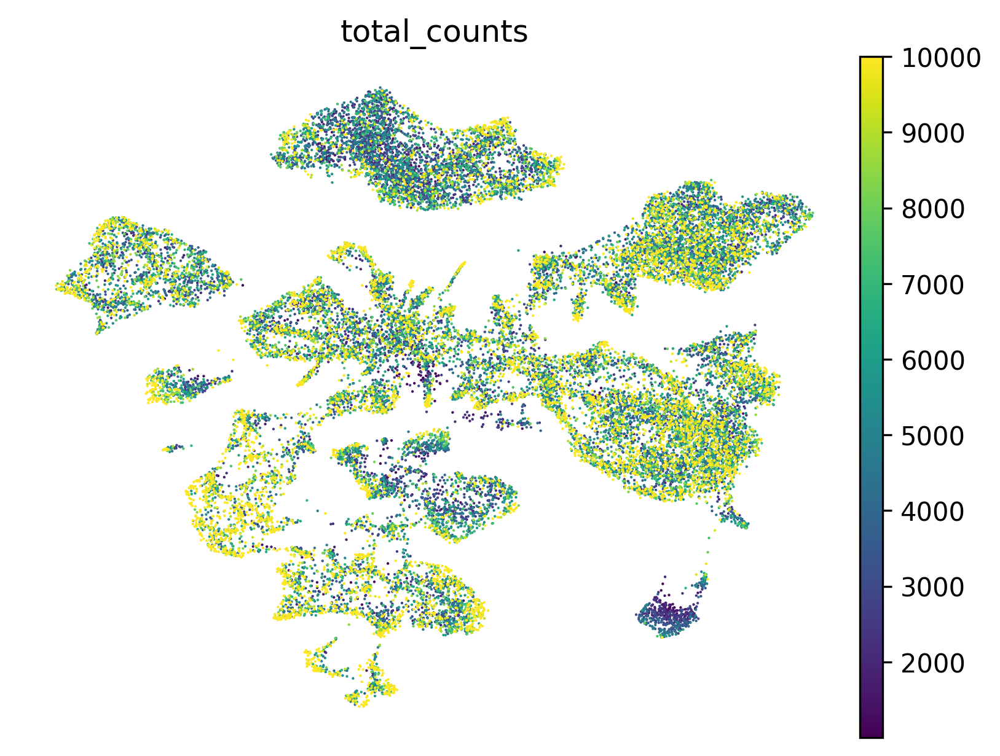

In [59]:
sc.pl.umap(adata, color = ['total_counts'], frameon = False, vmax = 10000)

In [49]:
plt.rcParams['figure.dpi'] = 300

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


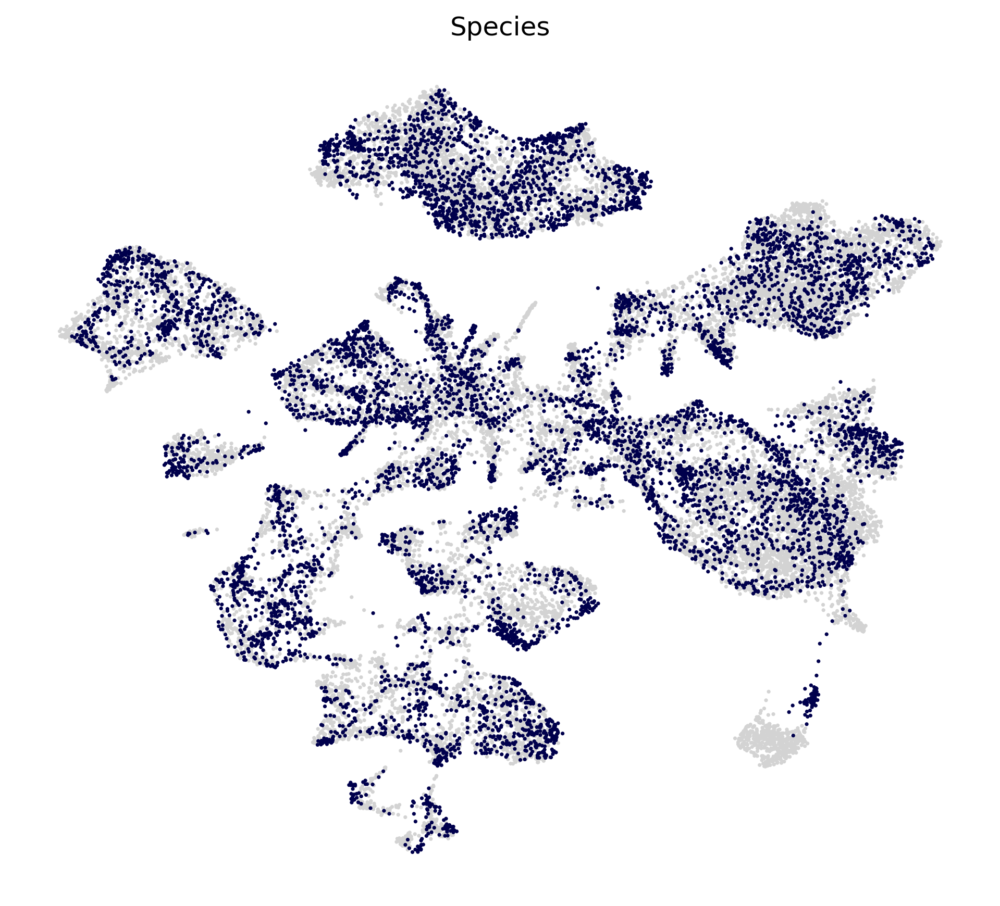

In [68]:
plt.figure(figsize=(8,7))
ax=plt.subplot(1,1,1)
excolors = {'Mouse':(0.8,0.8,0.8,1),'Rat':(0, 0, 0.3)}
sc.pl.umap(adata, color = ['Species'], groups = ['Rat'], size = 12, frameon = False, palette=excolors,  ax=ax, show=False, legend_loc='off')
plt.savefig(directory + '/Figures/VPSpecies.png')

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


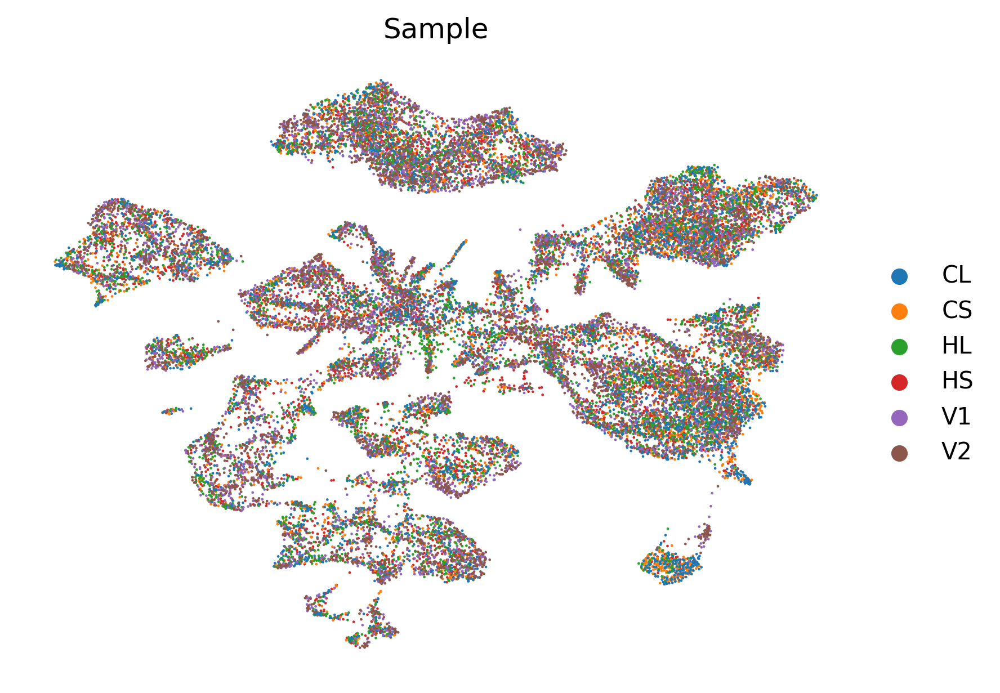

In [61]:
kwargs = {'alpha': 1}
sc.pl.umap(adata, color = ['Sample'], size = 5, frameon = False, **kwargs)

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


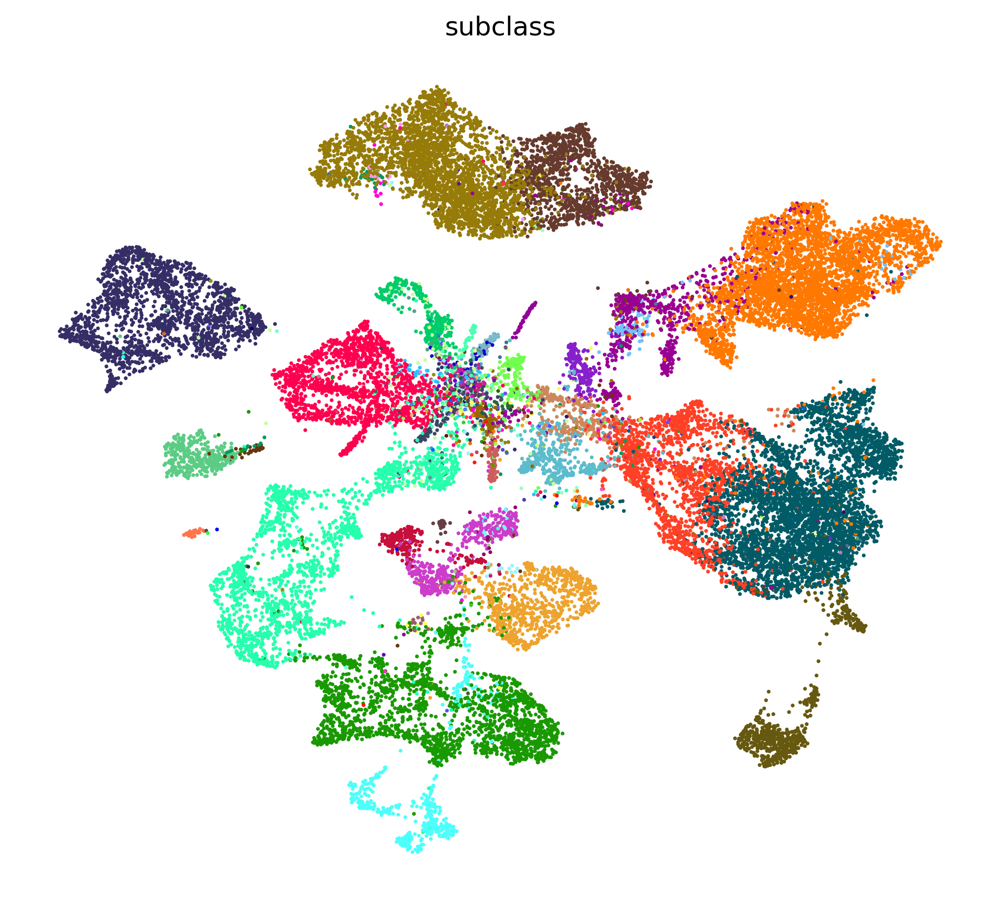

In [67]:
subclasses = np.unique(adata.obs['subclass'])
groups = subclasses[subclasses!='None']

plt.figure(figsize=(8,7))
ax=plt.subplot(1,1,1)
sc.pl.umap(adata, color = ['subclass'], groups = groups.tolist(), size = 12, frameon = False, palette=subclassp, ax=ax, show=False, legend_loc='off')
plt.savefig(directory + '/Figures/VPSubclass.png')

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


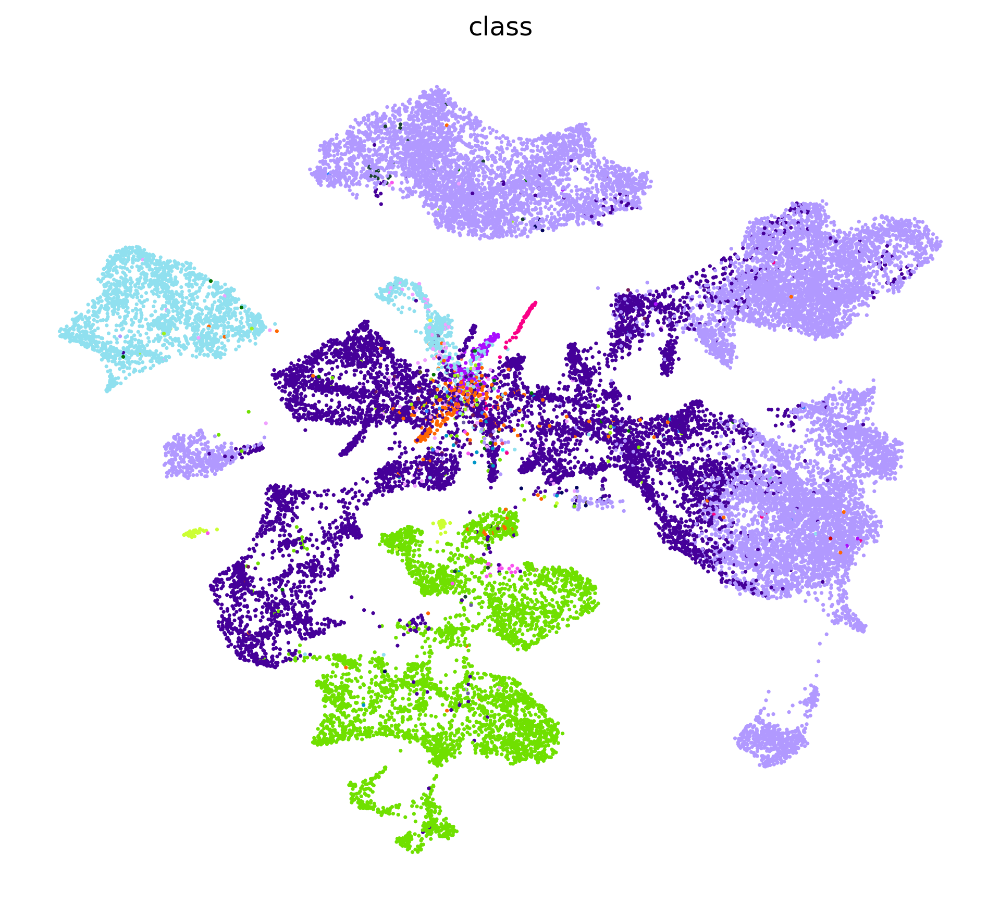

In [66]:
plt.figure(figsize=(8,7))
ax=plt.subplot(1,1,1)
sc.pl.umap(adata, color = ['class'], size = 12, frameon = False, palette=classp, ax=ax, show=False, legend_loc='off')
plt.savefig(directory + '/Figures/VPclass.png')

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


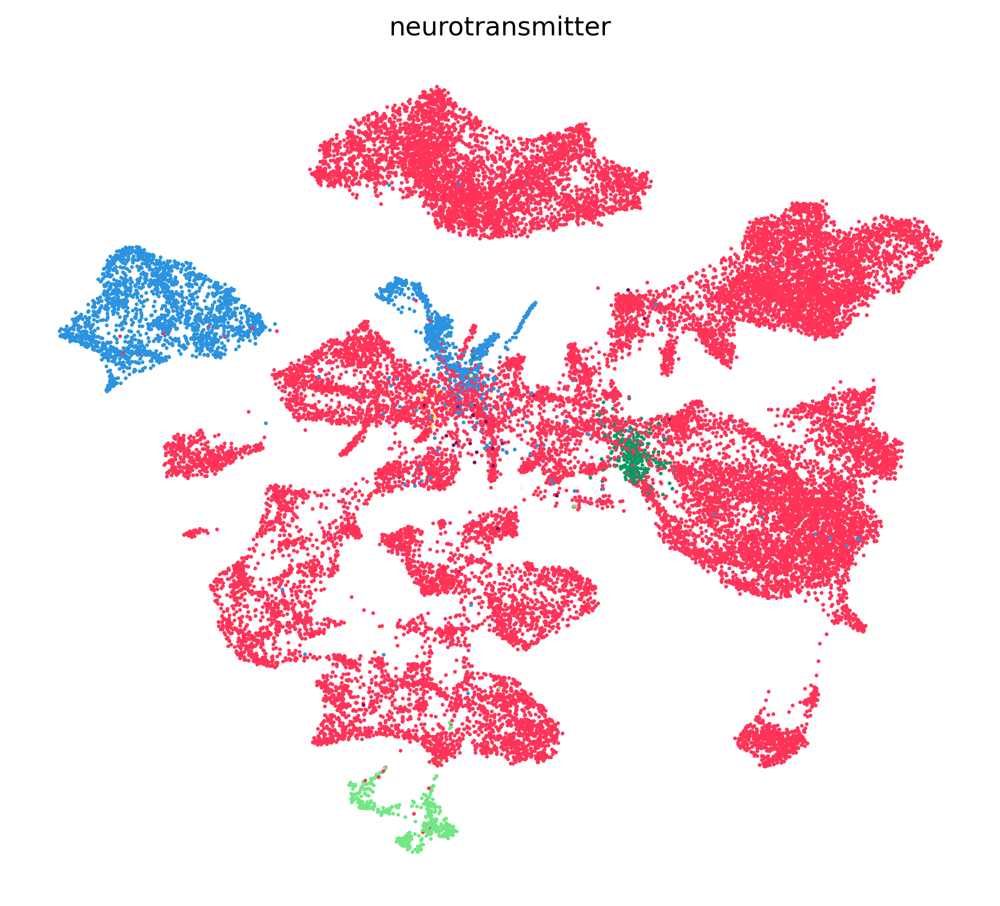

In [69]:
plt.figure(figsize=(8,7))
ax=plt.subplot(1,1,1)
sc.pl.umap(adata, color = ['neurotransmitter'], size = 12, frameon = False, palette=neurotransmitterp, ax=ax, show=False, legend_loc='None')
plt.savefig(directory + '/Figures/VPNT.png')

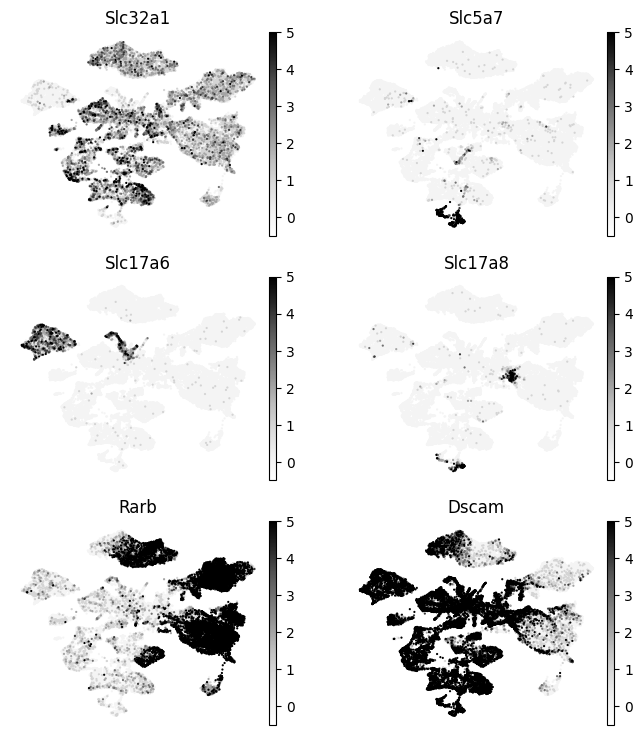

In [4]:
#look at gene expression
plt.figure(figsize = (8,9))
um = plt.subplot(3,2,1)
um = sc.pl.umap(adata, color = ['Slc32a1'], frameon = False,
                size=10, ax = um, layer = 'counts', vmin=-0.5, vmax=5,
                cmap='Grays',show=False)
um = plt.subplot(3,2,2)
um = sc.pl.umap(adata, color = ['Slc5a7'], frameon = False,
                size=10, ax = um, layer = 'counts', vmin=-0.5, vmax=5,
                cmap='Grays',show=False)
um = plt.subplot(3,2,3)
um = sc.pl.umap(adata, color = ['Slc17a6'], frameon = False,
                size=10, ax = um, layer = 'counts', vmin=-0.5, vmax=5,
                cmap='Grays',show=False)
um = plt.subplot(3,2,4)
um = sc.pl.umap(adata, color = ['Slc17a8'], frameon = False,
                size=10, ax = um, layer = 'counts', vmin=-0.5, vmax=5,
                cmap='Grays',show=False)
um = plt.subplot(3,2,5)
um = sc.pl.umap(adata, color = ['Rarb'], frameon = False,
                size=10, ax = um, layer = 'counts', vmin=-0.5, vmax=5,
                cmap='Grays',show=False)
um = plt.subplot(3,2,6)
um = sc.pl.umap(adata, color = ['Dscam'], frameon = False,
                size=10, ax = um, layer = 'counts', vmin=-0.5, vmax=5,
                cmap='Grays',show=False)

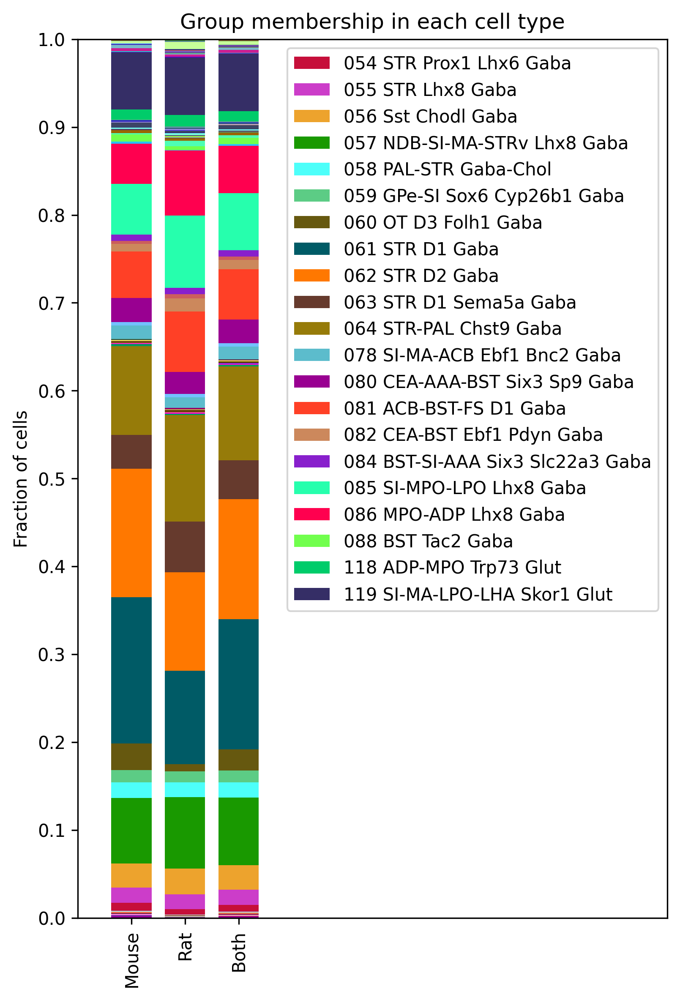

In [78]:
#get subclass proportions for mouse, rat, and all neurons
order = [['Mouse'],['Rat'],['Mouse','Rat']]
groupnames = np.unique(adata.obs['subclass'])
typecount=np.zeros((len(groupnames),len(order)))
for g in range(0,len(groupnames)):   
    for t in range(0,len(order)):
        typecount[g,t]=np.sum((adata.obs['Species'].isin(order[t])) & (adata.obs['subclass']==groupnames[g]))                   

tcn = np.divide(typecount,np.sum(typecount,axis=0))

width = 0.75

fig, ax = plt.subplots(figsize = (6,9))
bottom = np.zeros(len(order))

lhs=[]
inc=np.full((len(groupnames),1),False,dtype='bool')
inccolors=[]
for g in range(0,len(groupnames)):
    p = ax.bar(('Mouse','Rat','Both'), tcn[g,:], width, label=groupnames[g], bottom=bottom, color=subclassp[groupnames[g]])
    bottom += tcn[g,:]
    if np.max(tcn[g,2])>=0.005:
        lhs.append(p)
        inc[g]=True
        inccolors.append(subclassp[groupnames[g]])
inc=inc.squeeze()

ax.legend(handles=lhs,loc="upper right", ncols=1)

plt.title('Group membership in each cell type')
plt.xlim((-1,10))
plt.xticks(rotation=90)
plt.yticks(np.arange(0,1.1,0.1))
plt.ylabel('Fraction of cells')
plt.savefig(directory + '/Figures/specSubclass.svg')

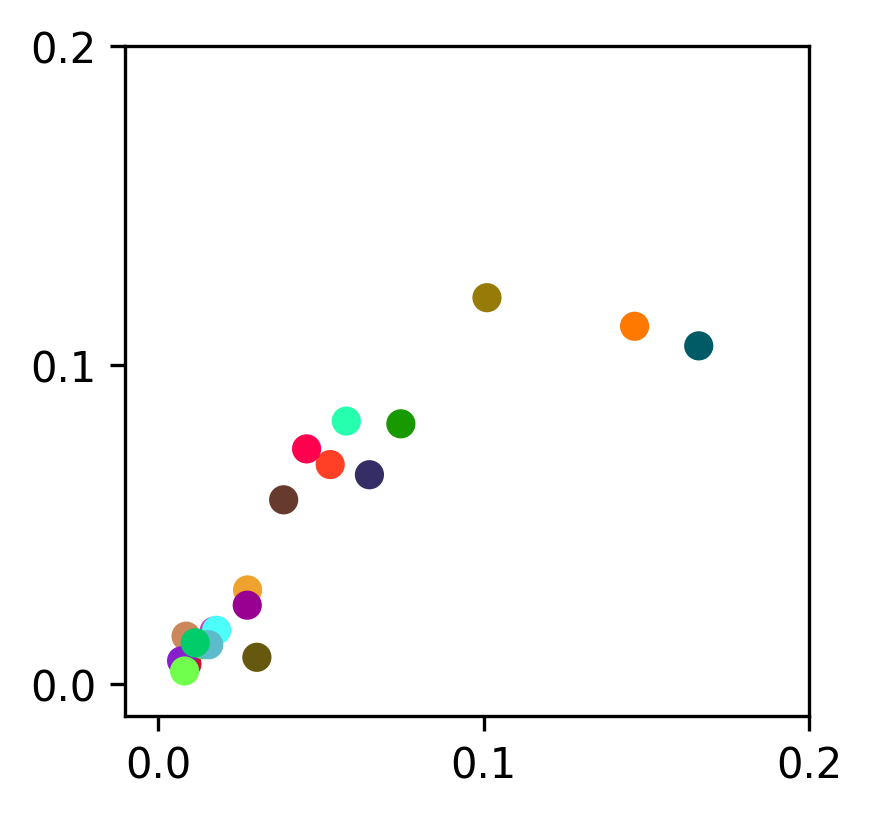

In [83]:
#compare mouse and rat
colororder=[]
for x in range(0,len(groupnames)):
    colororder.append(subclassp[groupnames[x]])

plt.figure(figsize=(10,2.9))
plt.subplot(1,3,1)
plt.scatter(tcn[inc,0],tcn[inc,1],c=inccolors)
plt.xlim((-0.01,0.2))
plt.ylim((-0.01,0.2))
plt.xticks((0,0.1,0.2))
plt.yticks((0,0.1,0.2))

plt.savefig(directory + '/Figures/subclassComp.svg')

In [153]:
scipy.stats.spearmanr(tcn[inc,0],tcn[inc,1])

SignificanceResult(statistic=0.9126340202023367, pvalue=8.142287957773485e-09)

## merfish analysis

In [88]:
#summarize merfish counts for these subclasses, data from Allen Brain Cell Atlas
merfish = pd.read_csv(directory + '/MERFISH.csv', index_col=0)

In [100]:
merfishNorm = merfish/merfish[merfish.index=='Total'].to_numpy()

In [101]:
merfishNorm

,MERFISH C1,MERFISH C2,MERFISH S1,MERSCOPE
Subclass,,,,
54,0.002541,0.003119,0.005003,0.003136
55,0.008013,0.009356,0.009728,0.009570
56,0.030291,0.028067,0.025848,0.033534
57,0.152042,0.135135,0.099222,0.201850
58,0.038890,0.036902,0.027515,0.049698
59,0.021302,0.018191,0.012785,0.020105
60,0.118233,0.163721,0.269316,0.036751
61,0.111198,0.120582,0.158977,0.066345
62,0.103185,0.096154,0.125625,0.043908


In [104]:
allProp = np.concatenate((tcn[inc,0:2],merfishNorm[merfish.index!='Total'].to_numpy()),axis=1)

In [226]:
#main subclasses we detected
maingroups = [
          '054','055','056','057','058','059',
            '060','061','062','063',
          '064','078','080','081','082','084','085',
          '086','088','118','119'
         ]

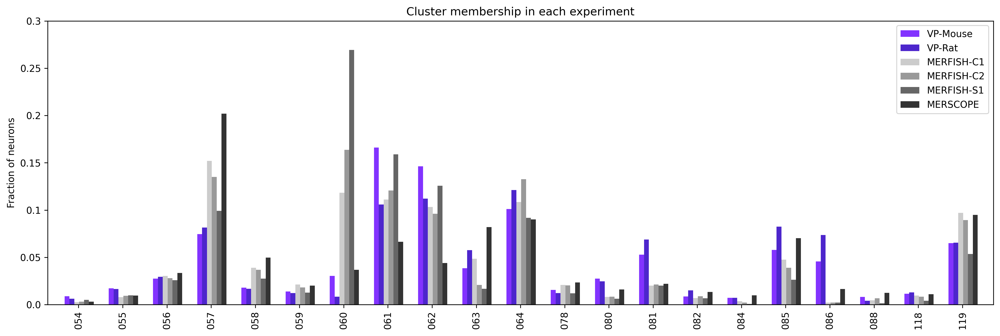

In [122]:
rscolors = {'VP-Mouse':(0.51, 0.2, 1, 1),'VP-Rat':(0.3, 0.15, 0.8, 1),
            'MERFISH-C1':(0.8,0.8,0.8),'MERFISH-C2':(0.6,0.6,0.6),
            'MERFISH-S1':(0.4,0.4,0.4),'MERSCOPE':(0.2,0.2,0.2)}
order = ['VP-Mouse','VP-Rat','MERFISH-C1','MERFISH-C2','MERFISH-S1','MERSCOPE']
plt.figure(figsize = (18,25))
ax = plt.subplot(4,1,1)
width = 0.11
bottom = np.zeros(len(maingroups))

for t in range(0,len(order)):
    p = ax.bar(np.arange(0,len(maingroups))+(width*(t-1))-0.15, allProp[:,t], width, label=order[t], bottom=bottom, color=rscolors[order[t]])
    #bottom += tcn[g,:]

plt.title('Cluster membership in each experiment')
ax.legend(loc="upper right")
plt.xlim((-0.7,len(maingroups)-0.3))
plt.xticks(range(0,len(maingroups)),labels=maingroups,rotation=90)
plt.yticks(3*np.arange(0,7)/60,3*np.arange(0,7)/60)

plt.ylabel('Fraction of neurons')
plt.savefig(directory + '/Figures/fishCounts.svg')

In [146]:
merCombined = np.sum(merfish,axis=1)
normCombined = merCombined[0:21].to_numpy()/merCombined.iloc[-1]

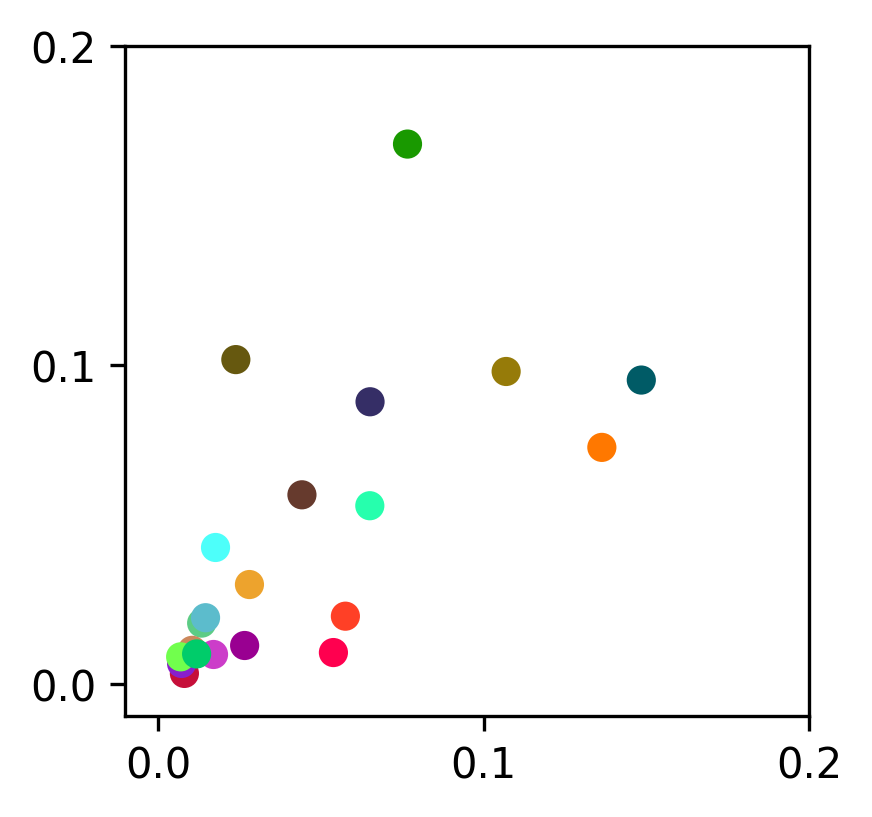

In [148]:
#compare RNA-seq to MERFISH
colororder=[]
for x in range(0,len(groupnames)):
    colororder.append(subclassp[groupnames[x]])

plt.figure(figsize=(10,2.9))
plt.subplot(1,3,1)
plt.scatter(tcn[inc,2],normCombined,c=inccolors)
plt.xlim((-0.01,0.2))
plt.ylim((-0.01,0.2))
plt.xticks((0,0.1,0.2))
plt.yticks((0,0.1,0.2))

plt.savefig(directory + '/Figures/fishComp.svg')

In [154]:
scipy.stats.spearmanr(tcn[inc,2],normCombined)

SignificanceResult(statistic=0.8064935064935065, pvalue=1.0075535527922042e-05)

## find marker genes for subclasses

In [228]:
adataSub = adata[adata.obs['subclass'].astype('U3').isin(maingroups)]

In [234]:
sc.pp.normalize_total(adataSub, target_sum = 1e4)
sc.pp.log1p(adataSub)

In [239]:
sc.tl.rank_genes_groups(adataSub, 'subclass', method='wilcoxon')

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the res

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored

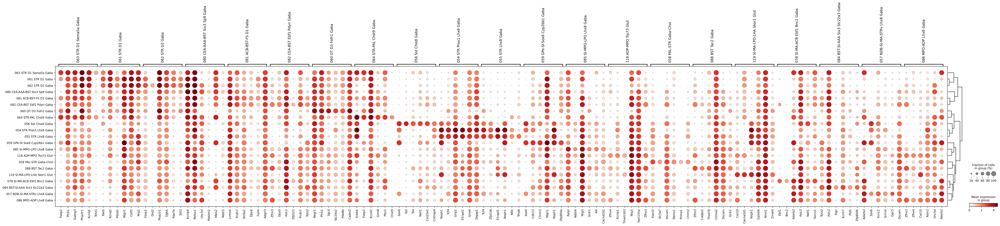

In [240]:
sc.pl.rank_genes_groups_dotplot(adataSub,n_genes=6)

## differentiate ventral striatum neurons from ventral pallidum neurons

In [155]:
#assign cells to brain region according to Allen subclass
vpSubclasses = ['055 STR Lhx8 Gaba','056 Sst Chodl Gaba','058 PAL-STR Gaba-Chol','064 STR-PAL Chst9 Gaba','081 ACB-BST-FS D1 Gaba',
         '057 NDB-SI-MA-STRv Lhx8 Gaba','059 GPe-SI Sox6 Cyp26b1 Gaba','078 SI-MA-ACB Ebf1 Bnc2 Gaba','080 CEA-AAA-BST Six3 Sp9 Gaba',
         '082 CEA-BST Ebf1 Pdyn Gaba','084 BST-SI-AAA Six3 Slc22a3 Gaba',
         '085 SI-MPO-LPO Lhx8 Gaba','086 MPO-ADP Lhx8 Gaba','088 BST Tac2 Gaba',
         '118 ADP-MPO Trp73 Glut','119 SI-MA-LPO-LHA Skor1 Glut']
        

vsSubclasses = ['054 STR Prox1 Lhx6 Gaba','060 OT D3 Folh1 Gaba','061 STR D1 Gaba','062 STR D2 Gaba','063 STR D1 Sema5a Gaba',
               '055 STR Lhx8 Gaba','056 Sst Chodl Gaba','058 PAL-STR Gaba-Chol',
                '064 STR-PAL Chst9 Gaba','078 SI-MA-ACB Ebf1 Bnc2 Gaba','081 ACB-BST-FS D1 Gaba']
adata.obs['Region']='Other'
adata.obs['Region'][adata.obs['subclass'].isin(vpSubclasses)]='VP'
adata.obs['Region'][adata.obs['subclass'].isin(vsSubclasses)]='STRv'
adata.obs['Region'][adata.obs['subclass'].isin(np.intersect1d(vpSubclasses,vsSubclasses))]='Both'

/var/folders/0d/m1rp2vsn40550y2btkrfwptr0000gn/T/ipykernel_24952/343325152.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs['Region'][adata.obs['subclass'].isin(vpSubclasses)]='VP'
/var/folders/0d/m1rp2vsn40550y2btkrfwptr0000gn/T/ipykernel_24952/343325152.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs['Region'][adata.obs['subclass'].isin(vsSubclasses)]='STRv'
/var/folders/0d/m1rp2vsn40550y2btkrfwptr0000gn/T/ipykernel_24952/343325152.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


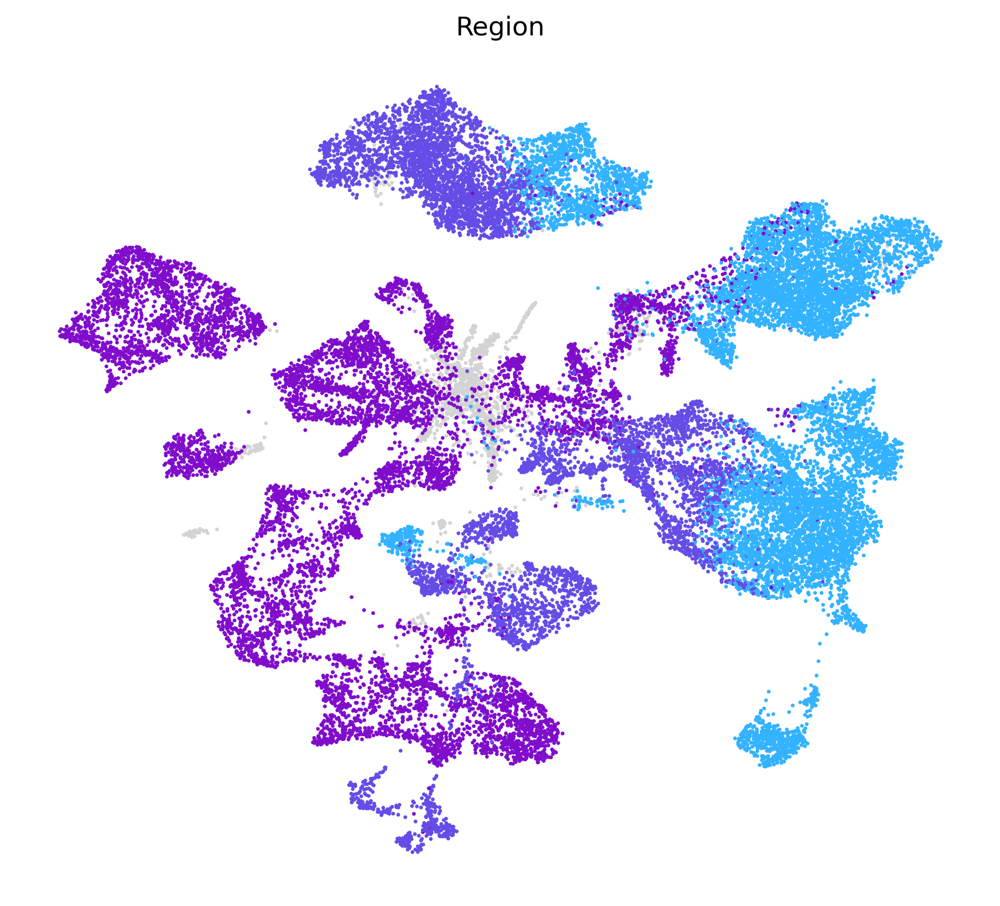

In [159]:
regcolors = {'STRv':(0.2, 0.7, 1,1),'Other':(0.6,0.6,0.6,1),'VP':(0.5, 0.05, 0.8, 1),'Both':(0.4,0.3,0.9,1)}

plt.figure(figsize=(8,7))
ax=plt.subplot(1,1,1)
#sc.pl.umap(adata, color = ['Experiment'], size = 4, frameon = False, palette=excolors)
sc.pl.umap(adata, color = ['Region'], size = 12, groups = ['STRv','VP','Both'], frameon = False, palette = regcolors, legend_loc='None', ax=ax, show=False)
plt.savefig(directory + '/Figures/VPreg.png')

In [148]:
adata.X = adata.layers['counts'].copy()

In [ ]:
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)

In [154]:
goi = ['VP','STRv']
sc.tl.rank_genes_groups(adata, 'Region', method='wilcoxon',groups=goi)

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


In [155]:
sc.tl.dendrogram(adata, 'Region')

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()


categories: Both, Other, STRv, etc.
var_group_labels: VP, STRv


/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored

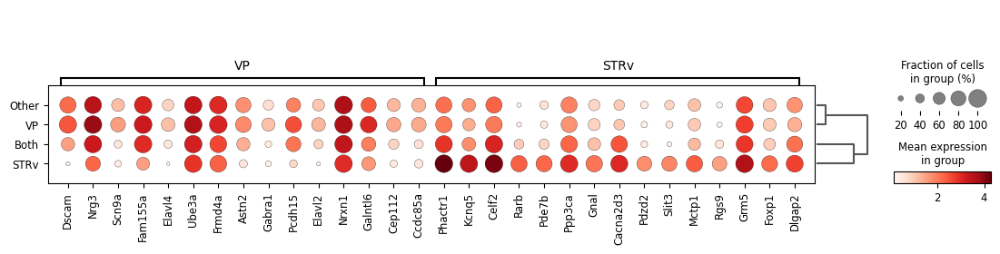

In [156]:
sc.pl.rank_genes_groups_dotplot(adata,n_genes=15)

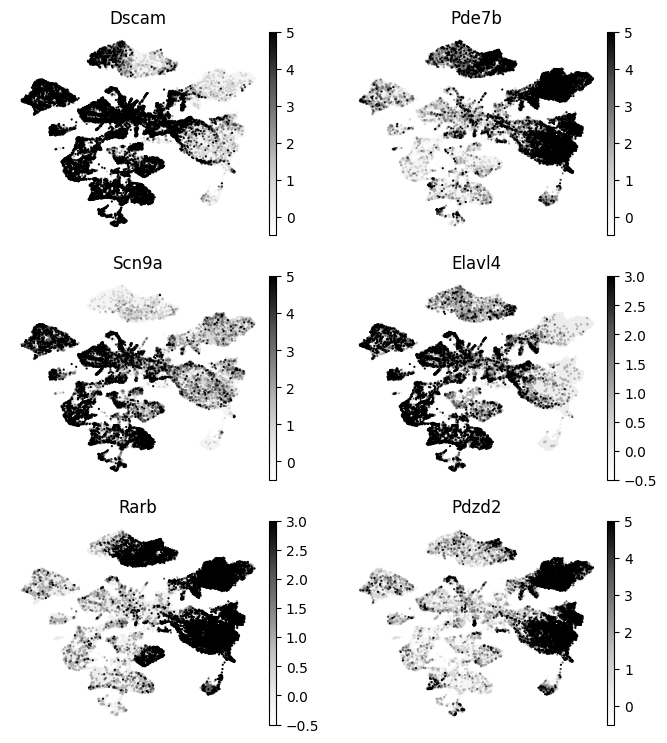

In [5]:
plt.figure(figsize = (8,9))
um = plt.subplot(3,2,1)
um = sc.pl.umap(adata, color = ['Dscam'], frameon = False,
                size=10, ax = um, layer = 'counts', vmin=-0.5, vmax=5,
                cmap='Grays',show=False)
um = plt.subplot(3,2,2)
um = sc.pl.umap(adata, color = ['Pde7b'], frameon = False,
                size=10, ax = um, layer = 'counts', vmin=-0.5, vmax=5,
                cmap='Grays',show=False)
um = plt.subplot(3,2,3)
um = sc.pl.umap(adata, color = ['Scn9a'], frameon = False,
                size=10, ax = um, layer = 'counts', vmin=-0.5, vmax=5,
                cmap='Grays',show=False)
um = plt.subplot(3,2,4)
um = sc.pl.umap(adata, color = ['Elavl4'], frameon = False,
                size=10, ax = um, layer = 'counts', vmin=-0.5, vmax=3,
                cmap='Grays',show=False)
um = plt.subplot(3,2,5)
um = sc.pl.umap(adata, color = ['Rarb'], frameon = False,
                size=10, ax = um, layer = 'counts', vmin=-0.5, vmax=3,
                cmap='Grays',show=False)
um = plt.subplot(3,2,6)
um = sc.pl.umap(adata, color = ['Pdzd2'], frameon = False,
                size=10, ax = um, layer = 'counts', vmin=-0.5, vmax=5,
                cmap='Grays',show=False)

## plot marker genes across subclasses

In [7]:
order = [ 
         '055 STR Lhx8 Gaba','056 Sst Chodl Gaba','057 NDB-SI-MA-STRv Lhx8 Gaba','058 PAL-STR Gaba-Chol','059 GPe-SI Sox6 Cyp26b1 Gaba',
         '064 STR-PAL Chst9 Gaba','078 SI-MA-ACB Ebf1 Bnc2 Gaba','080 CEA-AAA-BST Six3 Sp9 Gaba','081 ACB-BST-FS D1 Gaba',
         '082 CEA-BST Ebf1 Pdyn Gaba','084 BST-SI-AAA Six3 Slc22a3 Gaba',
         '085 SI-MPO-LPO Lhx8 Gaba','086 MPO-ADP Lhx8 Gaba','088 BST Tac2 Gaba',
         '118 ADP-MPO Trp73 Glut','119 SI-MA-LPO-LHA Skor1 Glut',
         '054 STR Prox1 Lhx6 Gaba','060 OT D3 Folh1 Gaba','061 STR D1 Gaba','062 STR D2 Gaba','063 STR D1 Sema5a Gaba',
        ]
#order.reverse()

In [8]:
adata.layers['counts_norm']=adata.layers['counts'].copy()
sc.pp.normalize_total(adata, target_sum = 1e4, layer='counts_norm')
#sc.pp.log1p(adata, layer='counts_norm')

In [6]:
#markers of interest
strv = ['Rarb','Pde7b','Pdzd2']
vp = ['Dscam','Scn9a','Elavl4']
nt = ['Slc32a1','Slc17a6','Slc17a7','Slc17a8','Slc5a7']
msn = ['Drd1','Drd2','Drd3','Ppp1r1b']
opioid = ['Penk','Pdyn','Pomc','Oprm1','Oprk1','Oprd1']             
tf = ['Nfib','Tcf4','Etv1','Nkx2-1','Lhx6','Lhx8','Sox6','Gbx1','Npas1','Casz1','Prox1','Meis2',
      'Foxp2','Ebf1','Six3','Zfhx3','Zfhx4','Tcf7l2']
marker = ['Moxd1','Sst','Npy','Tacr1','Gpc5','Elfn1','Cyp26b1','Penk','Chst9','Tshz1','Bnc2','Nts','Pdyn','Fign',
          'Trdn','Sema5a','Prlr','Tmem163','Calb2','Calb1','Drd3','Drd1','Drd2','Ppp1r1b']
hormones = ['Esr1','Esr2','Ar','Pgr','Crh','Crhr1','Crhr2','Nr3c1','Nr3c2','Ghrl','Mc4r','Mc5r','Lepr',
            'Sst','Sstr1','Sstr2','Sstr3','Sstr4',
            'Npy','Npy1r','Npy5r','Nts','Ntsr1','Hcrt','Hcrtr1','Hcrtr2','Prlr']
gaba = ['Slc32a1','Gad1','Gad2','Gabra1','Gabra2','Gabra3','Gabra4','Gabra5','Gabrb1','Gabrb2','Gabrb3',
        'Gabrg1','Gabrg2','Gabrg3','Gabrd','Gabrq','Gabrr1','Gabrr2','Gabrr3','Gabbr1','Gabbr2']
glutamate = ['Slc17a6','Slc17a7','Slc17a8','Gria1','Gria2','Gria4',
             'Grid1','Grid2','Grik1','Grik2','Grik3','Grik4','Grik5',
             'Grin1','Grin2a','Grin2b','Grin2c','Grin2d','Grin3a','Grin3b',
            'Grm1','Grm2','Grm3','Grm4','Grm5','Grm7','Grm8']
dopamine = ['Th','Drd1','Drd2','Drd3']
serotonin = ['Slc6a4','Htr1a','Htr1b','Htr1d','Htr1f','Htr2a','Htr2b','Htr2c','Htr3a',
             'Htr4','Htr5a','Htr5b','Htr6','Htr7']
ach = ['Slc5a7','Prima1','Chrna1','Chrna2','Chrna3','Chrna4','Chrna5','Chrna7','Chrna10',
       'Chrnb1','Chrnb2','Chrnb3','Chrnb4',
      'Chrm1','Chrm2','Chrm3','Chrm4','Chrm5']
glycine = ['Slc6a9','Glra1','Glra2','Glra3','Glra4','Glrb']
norep = ['Slc6a2','Adra1b','Adra1d','Adra2a','Adra2b','Adra2c','Adrb1']
other = ['Cnr1','Cnr2','Glp1r']
crhr1 = ['Crhr1','Hcn1','Hcn2','Hcn3','Hcn4']

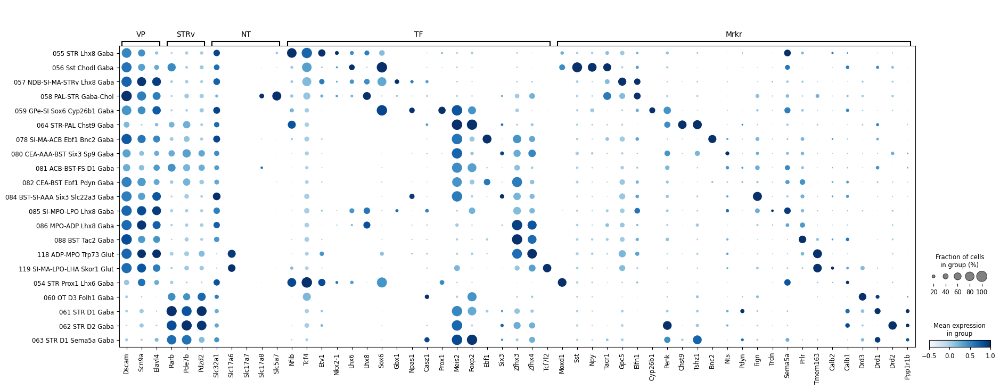

In [9]:
markers = {
           'VP': vp,
            'STRv': strv,
           'NT': nt,   
           'TF':tf,
           'Mrkr':marker ,
          }
dp = sc.pl.dotplot(adata[adata.obs['subclass'].isin(order)], markers, layer='counts_norm',groupby='subclass', categories_order=order,
                   standard_scale='var', vmin=-0.5, vmax=1,dendrogram=False, return_fig=True) 
dp.style(dot_edge_color=None, dot_edge_lw=0.5, cmap='Blues', x_padding=0.5, y_padding=0.5)

#dp.add_totals(sort=None, color='black').style(dot_edge_color=None, dot_edge_lw=0.5, cmap='Blues', x_padding=0.5, y_padding=0.5)
dp.savefig(directory + '/Figures/VPmarkers.svg')

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored

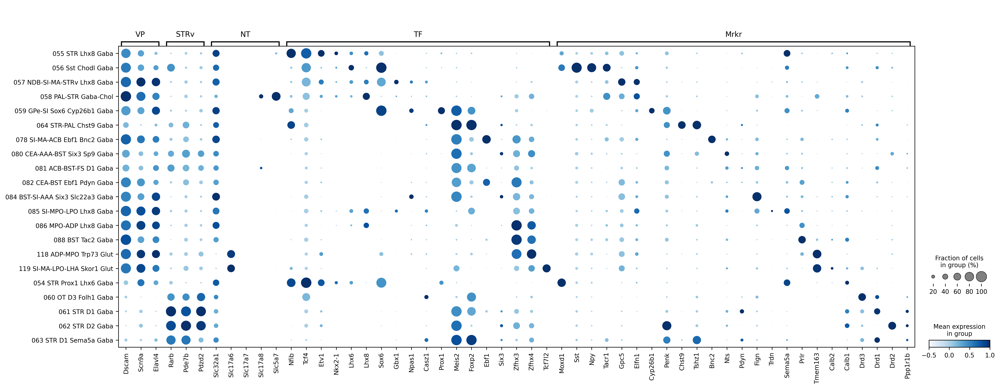

In [285]:
#mouse only
dp = sc.pl.dotplot(adata[(adata.obs['subclass'].isin(order)) & (adata.obs['Species']=='Mouse')], markers,
                   standard_scale='var', layer='counts_norm',groupby='subclass', categories_order=order, vmin=-0.5, vmax=1,dendrogram=False, return_fig=True) 
dp.style(dot_edge_color=None, dot_edge_lw=0.5, cmap='Blues', x_padding=0.5, y_padding=0.5)
dp.savefig(directory + '/Figures/VPmarkersM.svg')

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored

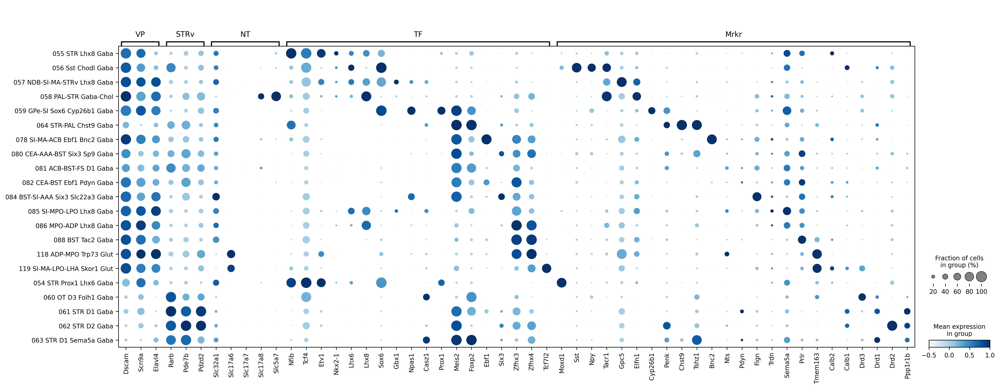

In [286]:
#rat only
dp = sc.pl.dotplot(adata[(adata.obs['subclass'].isin(order)) & (adata.obs['Species']=='Rat')], markers,
                   standard_scale='var', layer='counts_norm',groupby='subclass', categories_order=order, vmin=-0.5, vmax=1,dendrogram=False, return_fig=True) 
#dp.style(dot_edge_color=None, dot_edge_lw=0.5, cmap='Greens', x_padding=0.5, y_padding=0.5).show()
dp.style(dot_edge_color=None, dot_edge_lw=0.5, cmap='Blues', x_padding=0.5, y_padding=0.5)
dp.savefig(directory + '/Figures/VPmarkersR.svg')

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored

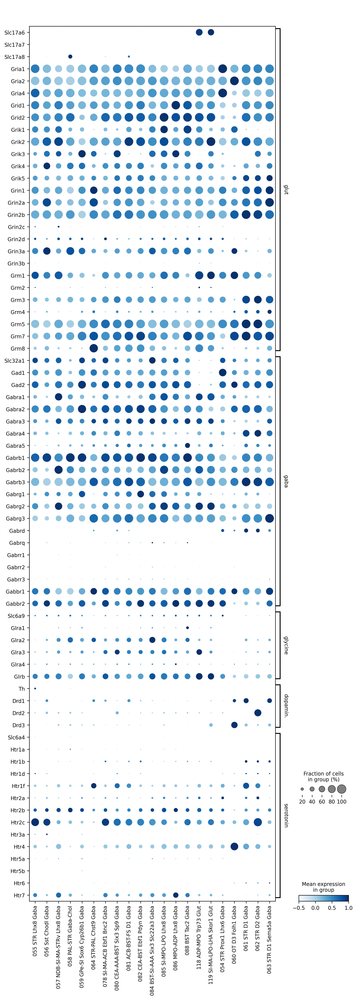

In [295]:
markers = {
           'glut': glutamate,
            'gaba': gaba,
           'glycine': glycine,
           'dopamine': dopamine,  
           'serotonin':serotonin,
          }
dp = sc.pl.dotplot(adata[adata.obs['subclass'].isin(order)], markers, layer='counts_norm',groupby='subclass', categories_order=order,
                   standard_scale='var', vmin=-0.5, vmax=1,dendrogram=False, return_fig=True, swap_axes=True) 
dp.style(dot_edge_color=None, dot_edge_lw=0.5, cmap='Blues', x_padding=0.5, y_padding=0.5)
#dp.add_totals(sort=None, color='black').style(dot_edge_color=None, dot_edge_lw=0.5, cmap='Blues', x_padding=0.5, y_padding=0.5).show()
dp.savefig(directory + '/Figures/VPmarkersS1.svg')

/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/david/opt/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored

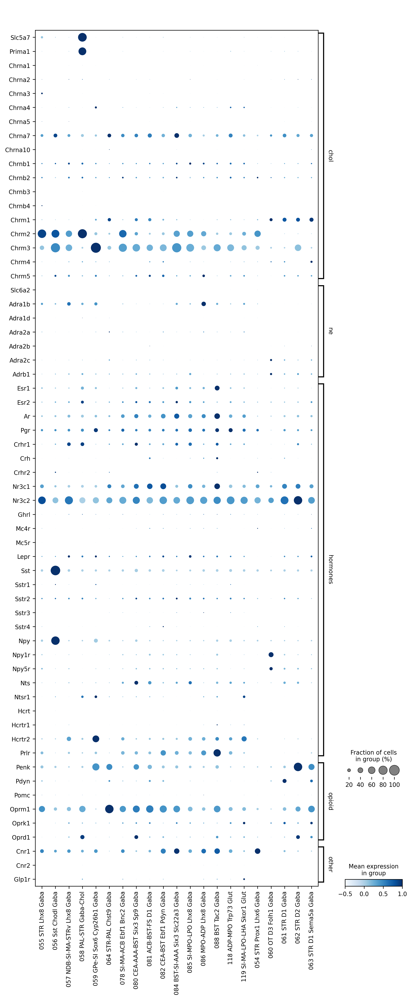

In [300]:
markers = {
            'chol':ach,
            'ne':norep,
            'hormones':hormones,
            'opioid':opioid,
            'other':other
          }
dp = sc.pl.dotplot(adata[adata.obs['subclass'].isin(order)], markers, layer='counts_norm',groupby='subclass', categories_order=order,
                   standard_scale='var', vmin=-0.5, vmax=1,dendrogram=False, return_fig=True, swap_axes=True) 
dp.style(dot_edge_color=None, dot_edge_lw=0.5, cmap='Blues', x_padding=0.5, y_padding=0.5)
#dp.add_totals(sort=None, color='black').style(dot_edge_color=None, dot_edge_lw=0.5, cmap='Blues', x_padding=0.5, y_padding=0.5).show()
dp.savefig(directory + '/Figures/VPmarkersS2.svg')


In [19]:
adata.write_h5ad(directory + '/MouseRatVP.h5ad')